# Stable Diffusion Benchmark

In [138]:
!nvidia-smi

Fri Dec  9 09:47:36 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  On   | 00000000:01:00.0 Off |                  N/A |
|  0%   28C    P8    16W / 250W |     84MiB / 11264MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  NVIDIA GeForce ...  On   | 00000000:02:00.0 Off |                  N/A |
|  0%   

In [2]:
import torch
torch.cuda.set_device(1)

/home/seb.derhy/anaconda3/envs/sdv2/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
# !pip install -Uq diffusers transformers fastcore

## Using Stable Diffusion

To run Stable Diffusion on your computer you have to accept the model license. It's an open CreativeML OpenRail-M license that claims no rights on the outputs you generate and prohibits you from deliberately producing illegal or harmful content. The [model card](https://huggingface.co/CompVis/stable-diffusion-v1-4) provides more details. If you do accept the license, you need to be a registered user in 🤗 Hugging Face Hub and use an access token for the code to work. You have two options to provide your access token:

* Use the `huggingface-cli login` command-line tool in your terminal and paste your token when prompted. It will be saved in a file in your computer.
* Or use `notebook_login()` in a notebook, which does the same thing.

In [7]:
from PIL import Image
from fastcore.all import concat
import torch, logging
from pathlib import Path
from huggingface_hub import notebook_login
from diffusers import StableDiffusionPipeline
from PIL import Image
import matplotlib.pyplot as plt
logging.disable(logging.WARNING)

if not (Path.home()/'.huggingface'/'token').exists(): notebook_login()

In [8]:
from tqdm.auto import tqdm

In [9]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

# Test pipeline

In [107]:
prompts = [
    'A photo of an astronaut riding a horse',
    'A photo of a handsome businesssman',
    'A photo of a human hand that actually looks like a hand with 5 fingers photo',
    'A photo of a model eating an ice cream'
]
guidance_scale = 7.5
num_inference_steps = 50

device = torch.device("cuda")
num_images_per_prompt = 1

In [108]:
from diffusers import StableDiffusionPipeline, EulerDiscreteScheduler
import torch

model_id = "stabilityai/stable-diffusion-2-base"

# Use the Euler scheduler here instead
scheduler = EulerDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")
pipe = StableDiffusionPipeline.from_pretrained(model_id, scheduler=scheduler, revision="fp16", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

Fetching 12 files: 100%|██████████| 12/12 [00:00<00:00, 20721.14it/s]


In [109]:
torch.manual_seed(42)
images = pipe(prompts, device=device, 
             guidance_scale=guidance_scale, 
             num_inference_steps=num_inference_steps, 
             num_images_per_prompt=num_images_per_prompt).images

100%|██████████| 50/50 [00:54<00:00,  1.09s/it]


In [110]:
len(images)

4

In [111]:
ref_images = images.copy()

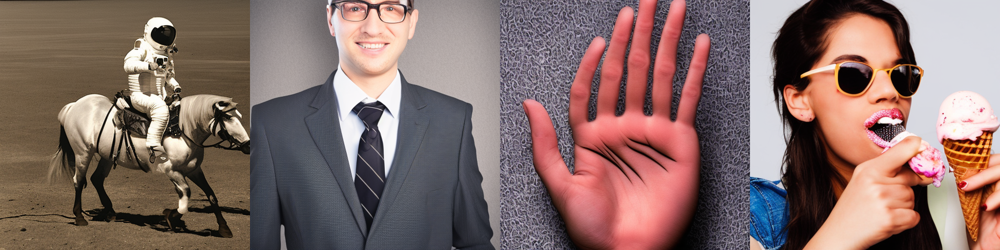

In [112]:
image_grid(ref_images, rows=num_images_per_prompt, cols=len(prompts))

# Reproduce inference loop 

In [113]:
def regular_update(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    # compute the previous noisy sample x_t -> x_t-1
    latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    return latents

In [114]:
def my_sd_sampling(prompt=prompts, device=device, 
             guidance_scale=guidance_scale, 
             num_inference_steps=num_inference_steps, 
             num_images_per_prompt=num_images_per_prompt, 
             custom_update=None):
    
    # 0. Default height and width to unet
    height = pipe.unet.config.sample_size * pipe.vae_scale_factor
    width = pipe.unet.config.sample_size * pipe.vae_scale_factor

    # 1. Check inputs. Raise error if not correct
    pipe.check_inputs(prompt, height, width, callback_steps=1)

    # 2. Define call parameters
    batch_size = 1 if isinstance(prompt, str) else len(prompt)

    # here `guidance_scale` is defined analog to the guidance weight `w` of equation (2)
    # of the Imagen paper: https://arxiv.org/pdf/2205.11487.pdf . `guidance_scale = 1`
    # corresponds to doing no classifier free guidance.
    do_classifier_free_guidance = guidance_scale > 1.0

    # 3. Encode input prompt
    text_embeddings = pipe._encode_prompt(prompt, device, num_images_per_prompt, 
                                          do_classifier_free_guidance, negative_prompt=None)

    # 4. Prepare timesteps
    pipe.scheduler.set_timesteps(num_inference_steps, device=device)
    timesteps = pipe.scheduler.timesteps

    # 5. Prepare latent variables
    num_channels_latents = pipe.unet.in_channels
    latents = pipe.prepare_latents(
        batch_size * num_images_per_prompt,
        num_channels_latents,
        height,
        width,
        text_embeddings.dtype,
        device,
        generator=None,
        latents=None,
    )

    with torch.no_grad():
        # 7. Denoising loop
        for i, t in enumerate(pipe.progress_bar(timesteps)):
            if custom_update is not None:
                latents = custom_update(latents, i, t, text_embeddings, do_classifier_free_guidance)
            else:
                latents = regular_update(latents, i, t, text_embeddings, do_classifier_free_guidance)

        # 8. Post-processing
        image = pipe.decode_latents(latents)

        # 9. Run safety checker
        image, has_nsfw_concept = pipe.run_safety_checker(image, device, text_embeddings.dtype)
        
        # 10. Convert to PIL
        images = pipe.numpy_to_pil(image)
    
    return images

In [115]:
torch.manual_seed(42)
imgs = my_sd_sampling()

100%|██████████| 50/50 [00:55<00:00,  1.10s/it]


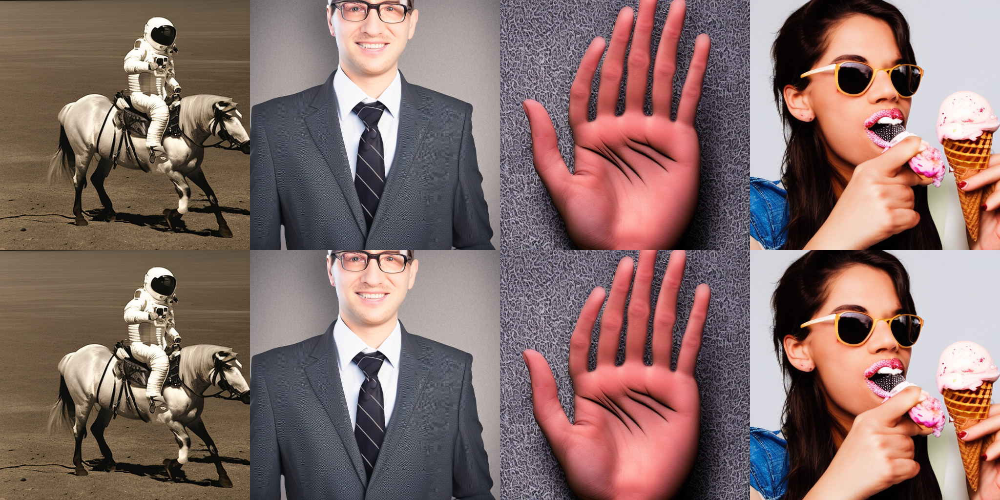

In [116]:
image_grid(ref_images + imgs, rows=2, cols=len(prompts))

# Improve the pipeline with rescale

In [117]:
def update_with_rescale(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)
        noise_pred = noise_pred/noise_pred.norm()*noise_pred_uncond.norm()

    # compute the previous noisy sample x_t -> x_t-1
    latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    return latents

In [118]:
torch.manual_seed(42)
imgs = my_sd_sampling(custom_update=update_with_rescale)

100%|██████████| 50/50 [00:55<00:00,  1.11s/it]


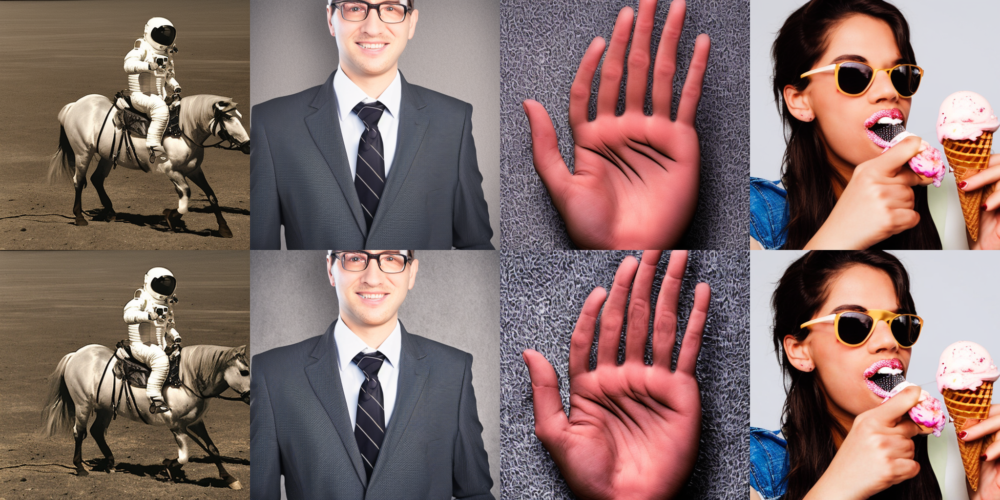

In [119]:
image_grid(ref_images + imgs, rows=2, cols=len(prompts))

In [120]:
mstn1 = imgs.copy()

# Improve the pipeline with another rescale

In [162]:
def update_with_rescale(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        dir_change = noise_pred_text/noise_pred_text.norm() - noise_pred_uncond/noise_pred_uncond.norm()
        noise_pred = noise_pred_uncond + guidance_scale * dir_change * noise_pred_uncond.norm()
#         noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)
#         noise_pred = noise_pred/noise_pred.norm()*noise_pred_uncond.norm()

    # compute the previous noisy sample x_t -> x_t-1
    latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    return latents

In [163]:
torch.manual_seed(42)
imgs = my_sd_sampling(custom_update=update_with_rescale)

100%|██████████| 50/50 [00:54<00:00,  1.10s/it]


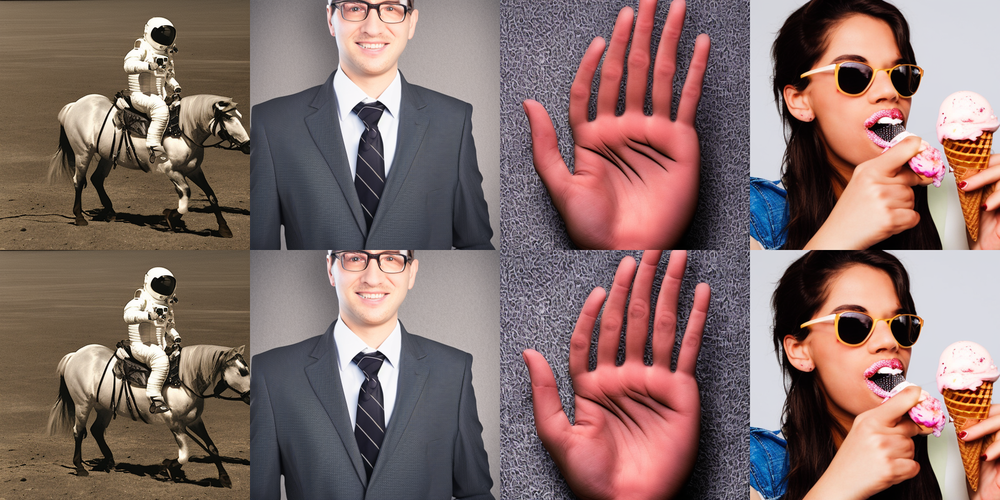

In [164]:
image_grid(ref_images + imgs, rows=2, cols=len(prompts))

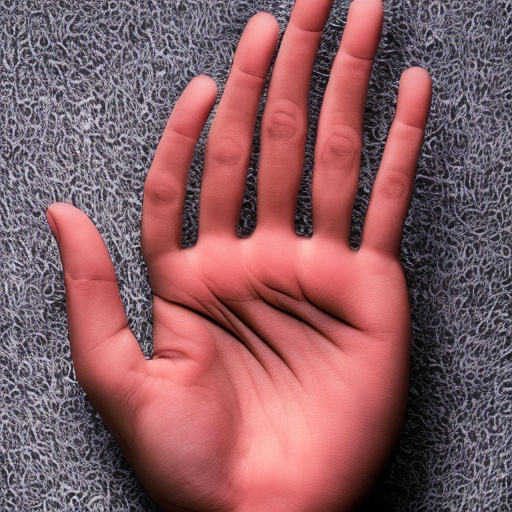

In [171]:
imgs[2]

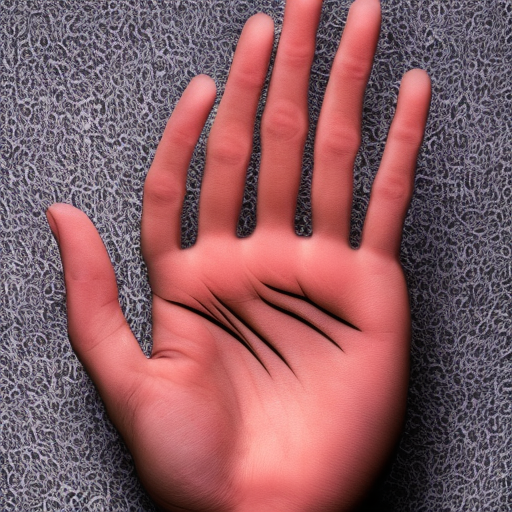

In [172]:
ref_images[2]

# Log some graphs into the pipeline

In [141]:
def update_with_debug_logs(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    # compute the previous noisy sample x_t -> x_t-1
    new_latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    latent_step = new_latents-latents 
    steps_unit_vecs.append(latent_step/latent_step.norm()) 
    steps_magnitudes.append(latent_step.norm())
    return new_latents

In [142]:
steps_unit_vecs = []
steps_magnitudes = []

In [143]:
torch.manual_seed(42)
imgs = my_sd_sampling(custom_update=update_with_debug_logs)

100%|██████████| 50/50 [00:54<00:00,  1.08s/it]


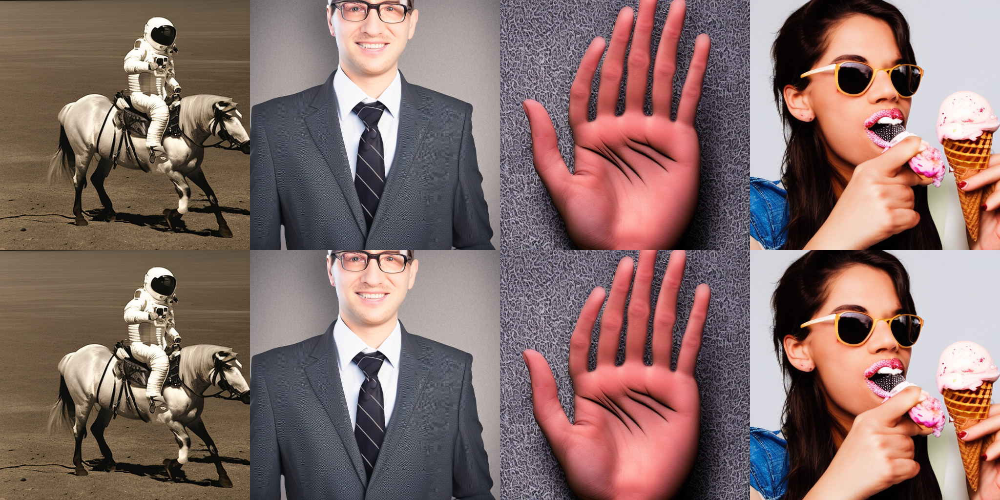

In [144]:
image_grid(ref_images + imgs, rows=2, cols=len(prompts))

In [156]:
dir_cosine_sim = [ (steps_unit_vecs[i+1].view(1, -1) @ steps_unit_vecs[i].view(1, -1).T).detach().cpu().numpy() 
                    for i in range(len(steps_unit_vecs)-1)]

In [46]:
dir_changes_norm = [(steps_unit_vecs[i+1] - steps_unit_vecs[i]).norm().detach().cpu().numpy() 
                    for i in range(len(steps_unit_vecs)-1)]
steps_norm = [sn.detach().cpu().numpy() for sn in steps_magnitudes]

Text(0.5, 1.0, 'Step Length')

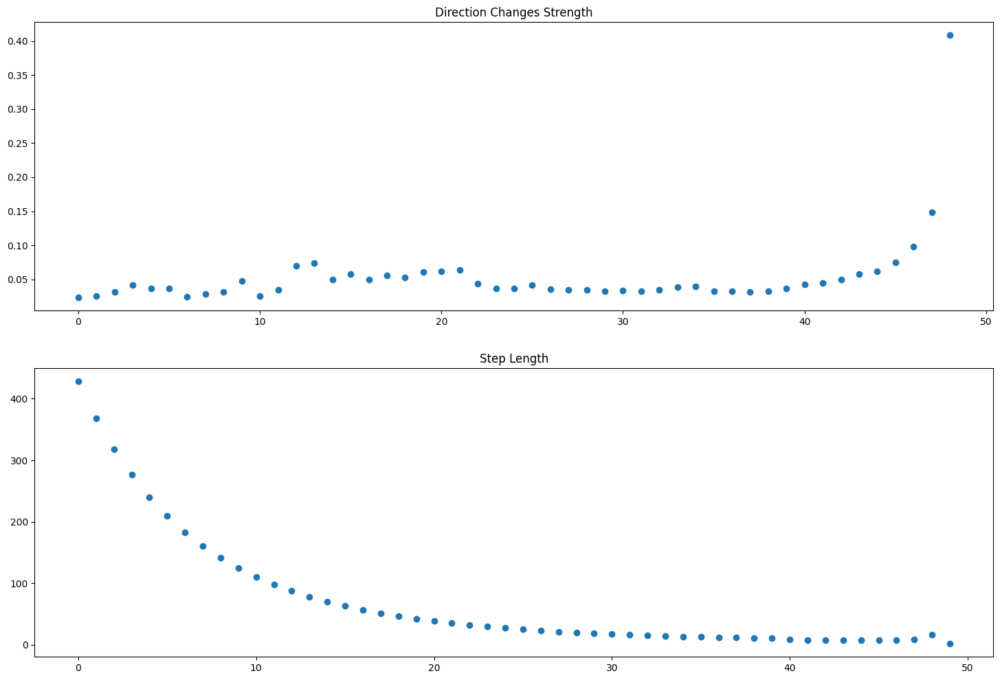

In [158]:
fig, axs = plt.subplots(2, 1, figsize=(18, 12))
axs[0].scatter(range(len(dir_changes_norm)), dir_changes_norm)
axs[0].set_title("Direction Changes Strength")
axs[1].scatter(range(len(steps_norm)), steps_norm)
axs[1].set_title("Step Length")

# Prevent overshooting at the end

In [123]:
def update_without_overshoot(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    # compute the previous noisy sample x_t -> x_t-1
    new_latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    if i>=round(0.8*num_inference_steps) and i!=num_inference_steps-1:
        new_latents = latents + 0.8 * (new_latents-latents)
        
    latent_step = new_latents-latents 
    steps_unit_vecs.append(latent_step/latent_step.norm()) 
    steps_magnitudes.append(latent_step.norm())
    return new_latents

In [124]:
steps_unit_vecs = []
steps_magnitudes = []

In [125]:
torch.manual_seed(42)
imgs = my_sd_sampling(custom_update=update_without_overshoot)

100%|██████████| 50/50 [00:54<00:00,  1.09s/it]


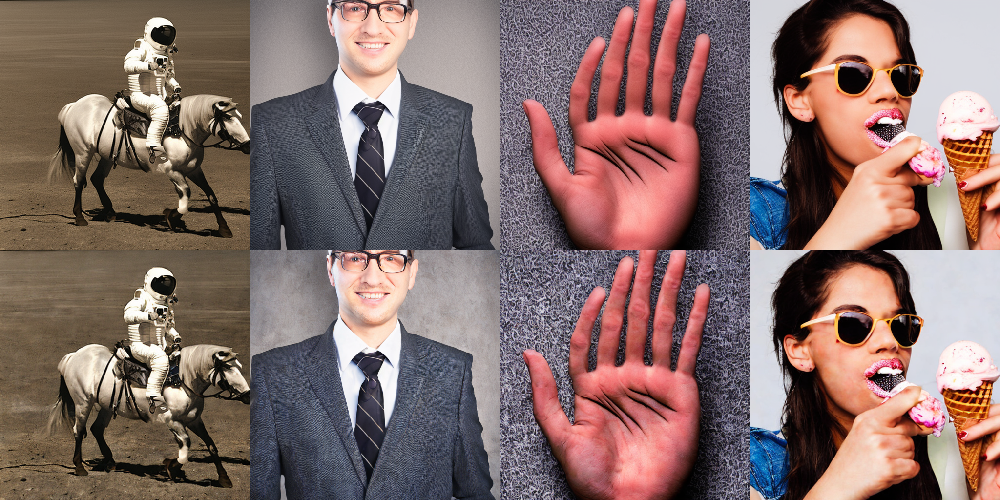

In [126]:
image_grid(ref_images + imgs, rows=2, cols=len(prompts))

In [127]:
dir_changes_norm = [(steps_unit_vecs[i+1] - steps_unit_vecs[i]).norm().detach().cpu().numpy() 
                    for i in range(len(steps_unit_vecs)-1)]
steps_norm = [sn.detach().cpu().numpy() for sn in steps_magnitudes]

Text(0.5, 1.0, 'Step Length')

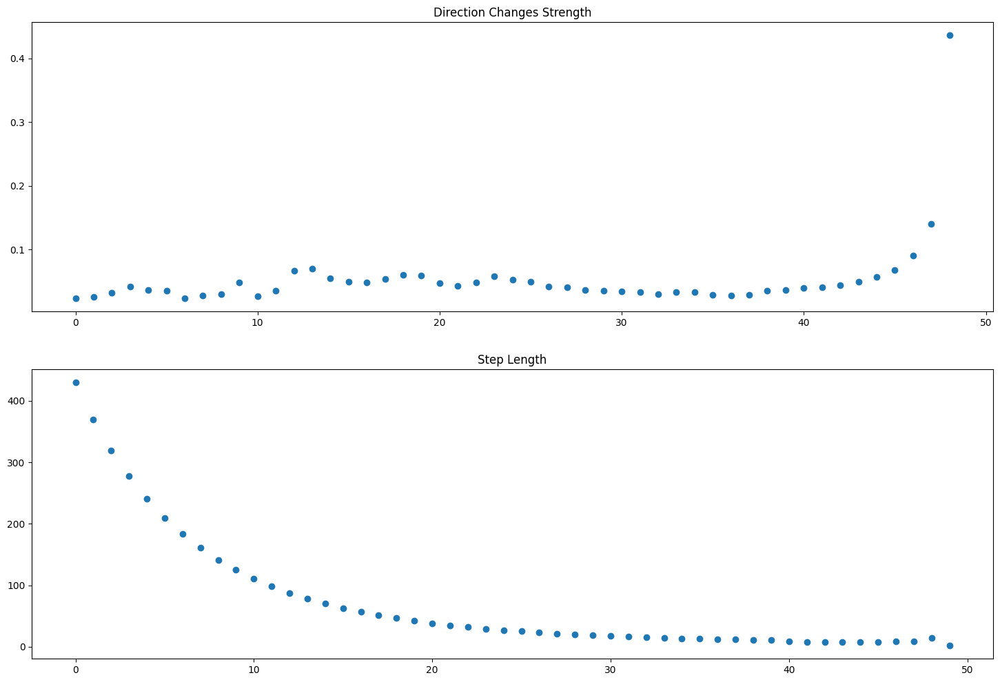

In [128]:
fig, axs = plt.subplots(2, 1, figsize=(18, 12))
axs[0].scatter(range(len(dir_changes_norm)), dir_changes_norm)
axs[0].set_title("Direction Changes Strength")
axs[1].scatter(range(len(steps_norm)), steps_norm)
axs[1].set_title("Step Length")

# Everything combined

In [183]:
def update_with_all_improvements(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        dir_change = noise_pred_text/noise_pred_text.norm() - noise_pred_uncond/noise_pred_uncond.norm()
        noise_pred = noise_pred_uncond + guidance_scale * dir_change * noise_pred_uncond.norm()
#         noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)
        noise_pred = noise_pred/noise_pred.norm()*noise_pred_uncond.norm()

    # compute the previous noisy sample x_t -> x_t-1
    new_latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    if i>=round(0.9*num_inference_steps) and i<num_inference_steps-2:
        new_latents = latents + 0.9 * (new_latents-latents)

    latent_step = new_latents-latents 
    steps_unit_vecs.append(latent_step/latent_step.norm()) 
    steps_magnitudes.append(latent_step.norm())
    return new_latents

In [184]:
steps_unit_vecs = []
steps_magnitudes = []

In [185]:
torch.manual_seed(42)
imgs = my_sd_sampling(custom_update=update_with_all_improvements)

100%|██████████| 50/50 [00:54<00:00,  1.09s/it]


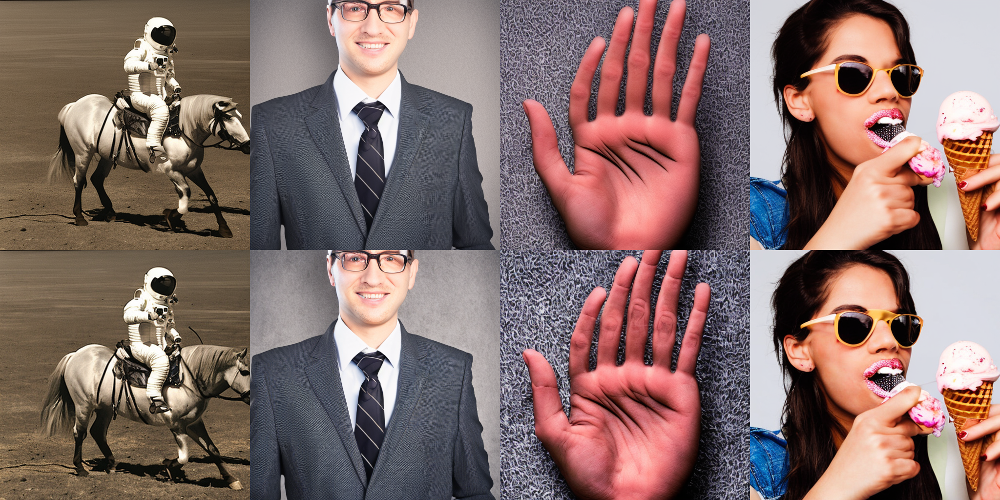

In [186]:
image_grid(ref_images + imgs, rows=2, cols=len(prompts))

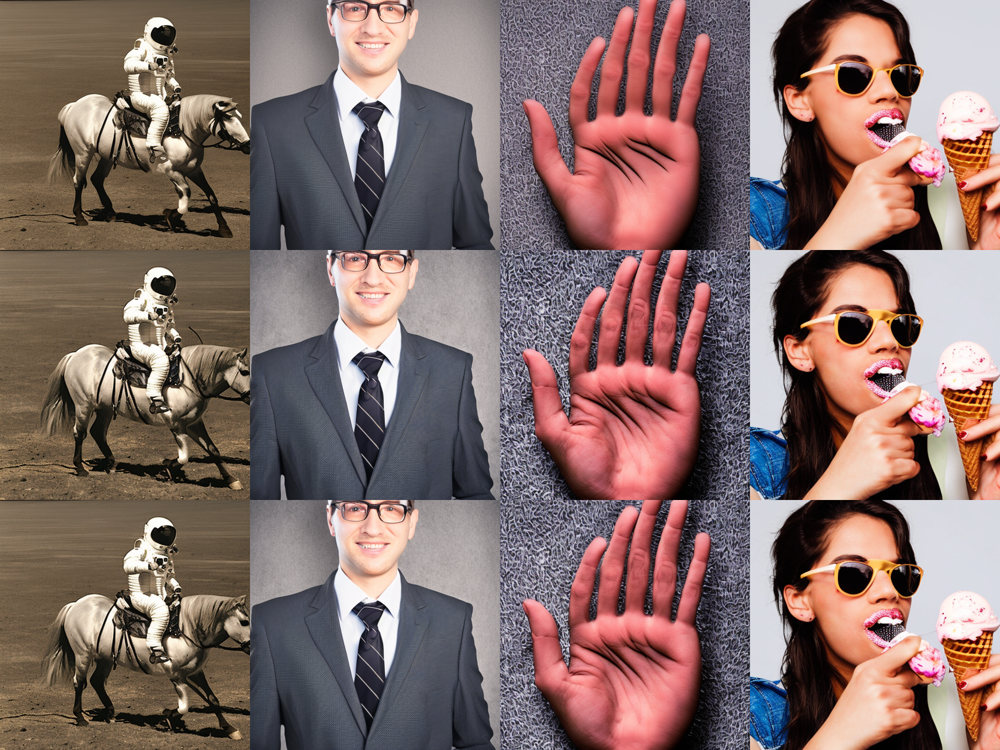

In [187]:
image_grid(ref_images + imgs + mstn1, rows=3, cols=len(prompts))

In [135]:
dir_changes_norm = [(steps_unit_vecs[i+1] - steps_unit_vecs[i]).norm().detach().cpu().numpy() 
                    for i in range(len(steps_unit_vecs)-1)]
steps_norm = [sn.detach().cpu().numpy() for sn in steps_magnitudes]

Text(0.5, 1.0, 'Step Length')

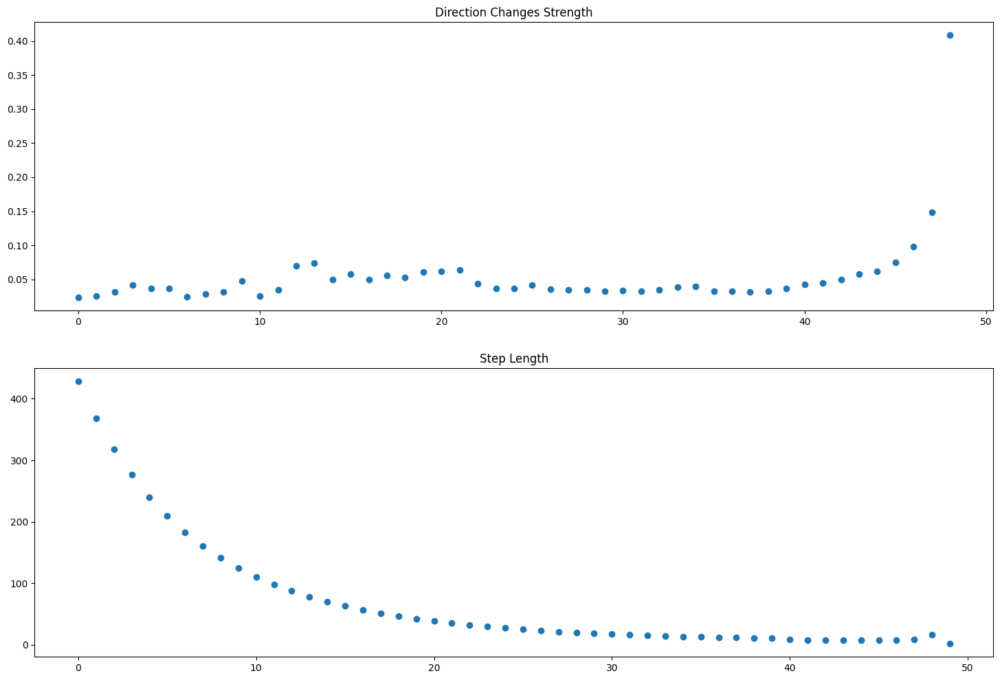

In [136]:
fig, axs = plt.subplots(2, 1, figsize=(18, 12))
axs[0].scatter(range(len(dir_changes_norm)), dir_changes_norm)
axs[0].set_title("Direction Changes Strength")
axs[1].scatter(range(len(steps_norm)), steps_norm)
axs[1].set_title("Step Length")

# Define my own scheduler

In [ ]:
from diffusers.schedulers import SchedulerMixin, Con

In [67]:
class EulerDiscreteScheduler(SchedulerMixin, ConfigMixin):
    """
    Euler scheduler (Algorithm 2) from Karras et al. (2022) https://arxiv.org/abs/2206.00364. . Based on the original
    k-diffusion implementation by Katherine Crowson:
    https://github.com/crowsonkb/k-diffusion/blob/481677d114f6ea445aa009cf5bd7a9cdee909e47/k_diffusion/sampling.py#L51

    [`~ConfigMixin`] takes care of storing all config attributes that are passed in the scheduler's `__init__`
    function, such as `num_train_timesteps`. They can be accessed via `scheduler.config.num_train_timesteps`.
    [`SchedulerMixin`] provides general loading and saving functionality via the [`SchedulerMixin.save_pretrained`] and
    [`~SchedulerMixin.from_pretrained`] functions.

    Args:
        num_train_timesteps (`int`): number of diffusion steps used to train the model.
        beta_start (`float`): the starting `beta` value of inference.
        beta_end (`float`): the final `beta` value.
        beta_schedule (`str`):
            the beta schedule, a mapping from a beta range to a sequence of betas for stepping the model. Choose from
            `linear` or `scaled_linear`.
        trained_betas (`np.ndarray`, optional):
            option to pass an array of betas directly to the constructor to bypass `beta_start`, `beta_end` etc.

    """

    _compatibles = _COMPATIBLE_STABLE_DIFFUSION_SCHEDULERS.copy()

    @register_to_config
    def __init__(
        self,
        num_train_timesteps: int = 1000,
        beta_start: float = 0.0001,
        beta_end: float = 0.02,
        beta_schedule: str = "linear",
        trained_betas: Optional[np.ndarray] = None,
        prediction_type: str = "epsilon",
    ):
        if trained_betas is not None:
            self.betas = torch.from_numpy(trained_betas)
        elif beta_schedule == "linear":
            self.betas = torch.linspace(beta_start, beta_end, num_train_timesteps, dtype=torch.float32)
        elif beta_schedule == "scaled_linear":
            # this schedule is very specific to the latent diffusion model.
            self.betas = (
                torch.linspace(beta_start**0.5, beta_end**0.5, num_train_timesteps, dtype=torch.float32) ** 2
            )
        else:
            raise NotImplementedError(f"{beta_schedule} does is not implemented for {self.__class__}")

        self.alphas = 1.0 - self.betas
        self.alphas_cumprod = torch.cumprod(self.alphas, dim=0)

        sigmas = np.array(((1 - self.alphas_cumprod) / self.alphas_cumprod) ** 0.5)
        sigmas = np.concatenate([sigmas[::-1], [0.0]]).astype(np.float32)
        self.sigmas = torch.from_numpy(sigmas)

        # standard deviation of the initial noise distribution
        self.init_noise_sigma = self.sigmas.max()

        # setable values
        self.num_inference_steps = None
        timesteps = np.linspace(0, num_train_timesteps - 1, num_train_timesteps, dtype=float)[::-1].copy()
        self.timesteps = torch.from_numpy(timesteps)
        self.is_scale_input_called = False

    def scale_model_input(
        self, sample: torch.FloatTensor, timestep: Union[float, torch.FloatTensor]
    ) -> torch.FloatTensor:
        """
        Scales the denoising model input by `(sigma**2 + 1) ** 0.5` to match the Euler algorithm.

        Args:
            sample (`torch.FloatTensor`): input sample
            timestep (`float` or `torch.FloatTensor`): the current timestep in the diffusion chain

        Returns:
            `torch.FloatTensor`: scaled input sample
        """
        if isinstance(timestep, torch.Tensor):
            timestep = timestep.to(self.timesteps.device)
        step_index = (self.timesteps == timestep).nonzero().item()
        sigma = self.sigmas[step_index]
        sample = sample / ((sigma**2 + 1) ** 0.5)
        self.is_scale_input_called = True
        return sample

    def set_timesteps(self, num_inference_steps: int, device: Union[str, torch.device] = None):
        """
        Sets the timesteps used for the diffusion chain. Supporting function to be run before inference.

        Args:
            num_inference_steps (`int`):
                the number of diffusion steps used when generating samples with a pre-trained model.
            device (`str` or `torch.device`, optional):
                the device to which the timesteps should be moved to. If `None`, the timesteps are not moved.
        """
        self.num_inference_steps = num_inference_steps

        timesteps = np.linspace(0, self.config.num_train_timesteps - 1, num_inference_steps, dtype=float)[::-1].copy()
        sigmas = np.array(((1 - self.alphas_cumprod) / self.alphas_cumprod) ** 0.5)
        sigmas = np.interp(timesteps, np.arange(0, len(sigmas)), sigmas)
        sigmas = np.concatenate([sigmas, [0.0]]).astype(np.float32)
        self.sigmas = torch.from_numpy(sigmas).to(device=device)
        if str(device).startswith("mps"):
            # mps does not support float64
            self.timesteps = torch.from_numpy(timesteps).to(device, dtype=torch.float32)
        else:
            self.timesteps = torch.from_numpy(timesteps).to(device=device)

    def step(
        self,
        model_output: torch.FloatTensor,
        timestep: Union[float, torch.FloatTensor],
        sample: torch.FloatTensor,
        s_churn: float = 0.0,
        s_tmin: float = 0.0,
        s_tmax: float = float("inf"),
        s_noise: float = 1.0,
        generator: Optional[torch.Generator] = None,
        return_dict: bool = True,
    ) -> Union[EulerDiscreteSchedulerOutput, Tuple]:
        """
        Predict the sample at the previous timestep by reversing the SDE. Core function to propagate the diffusion
        process from the learned model outputs (most often the predicted noise).

        Args:
            model_output (`torch.FloatTensor`): direct output from learned diffusion model.
            timestep (`float`): current timestep in the diffusion chain.
            sample (`torch.FloatTensor`):
                current instance of sample being created by diffusion process.
            s_churn (`float`)
            s_tmin  (`float`)
            s_tmax  (`float`)
            s_noise (`float`)
            generator (`torch.Generator`, optional): Random number generator.
            return_dict (`bool`): option for returning tuple rather than EulerDiscreteSchedulerOutput class

        Returns:
            [`~schedulers.scheduling_utils.EulerDiscreteSchedulerOutput`] or `tuple`:
            [`~schedulers.scheduling_utils.EulerDiscreteSchedulerOutput`] if `return_dict` is True, otherwise a
            `tuple`. When returning a tuple, the first element is the sample tensor.

        """

        if (
            isinstance(timestep, int)
            or isinstance(timestep, torch.IntTensor)
            or isinstance(timestep, torch.LongTensor)
        ):
            raise ValueError(
                "Passing integer indices (e.g. from `enumerate(timesteps)`) as timesteps to"
                " `EulerDiscreteScheduler.step()` is not supported. Make sure to pass"
                " one of the `scheduler.timesteps` as a timestep.",
            )

        if not self.is_scale_input_called:
            logger.warning(
                "The `scale_model_input` function should be called before `step` to ensure correct denoising. "
                "See `StableDiffusionPipeline` for a usage example."
            )

        if isinstance(timestep, torch.Tensor):
            timestep = timestep.to(self.timesteps.device)

        step_index = (self.timesteps == timestep).nonzero().item()
        sigma = self.sigmas[step_index]

        gamma = min(s_churn / (len(self.sigmas) - 1), 2**0.5 - 1) if s_tmin <= sigma <= s_tmax else 0.0

        device = model_output.device
        if device.type == "mps":
            # randn does not work reproducibly on mps
            noise = torch.randn(model_output.shape, dtype=model_output.dtype, device="cpu", generator=generator).to(
                device
            )
        else:
            noise = torch.randn(model_output.shape, dtype=model_output.dtype, device=device, generator=generator).to(
                device
            )

        eps = noise * s_noise
        sigma_hat = sigma * (gamma + 1)

        if gamma > 0:
            sample = sample + eps * (sigma_hat**2 - sigma**2) ** 0.5

        # 1. compute predicted original sample (x_0) from sigma-scaled predicted noise
        if self.config.prediction_type == "epsilon":
            pred_original_sample = sample - sigma_hat * model_output
        elif self.config.prediction_type == "v_prediction":
            # * c_out + input * c_skip
            pred_original_sample = model_output * (-sigma / (sigma**2 + 1) ** 0.5) + (sample / (sigma**2 + 1))
        else:
            raise ValueError(
                f"prediction_type given as {self.config.prediction_type} must be one of `epsilon`, or `v_prediction`"
            )

        # 2. Convert to an ODE derivative
        derivative = (sample - pred_original_sample) / sigma_hat

        dt = self.sigmas[step_index + 1] - sigma_hat

        prev_sample = sample + derivative * dt

        if not return_dict:
            return (prev_sample,)

        return EulerDiscreteSchedulerOutput(prev_sample=prev_sample, pred_original_sample=pred_original_sample)

    def add_noise(
        self,
        original_samples: torch.FloatTensor,
        noise: torch.FloatTensor,
        timesteps: torch.FloatTensor,
    ) -> torch.FloatTensor:
        # Make sure sigmas and timesteps have the same device and dtype as original_samples
        self.sigmas = self.sigmas.to(device=original_samples.device, dtype=original_samples.dtype)
        if original_samples.device.type == "mps" and torch.is_floating_point(timesteps):
            # mps does not support float64
            self.timesteps = self.timesteps.to(original_samples.device, dtype=torch.float32)
            timesteps = timesteps.to(original_samples.device, dtype=torch.float32)
        else:
            self.timesteps = self.timesteps.to(original_samples.device)
            timesteps = timesteps.to(original_samples.device)

        schedule_timesteps = self.timesteps
        step_indices = [(schedule_timesteps == t).nonzero().item() for t in timesteps]

        sigma = self.sigmas[step_indices].flatten()
        while len(sigma.shape) < len(original_samples.shape):
            sigma = sigma.unsqueeze(-1)

        noisy_samples = original_samples + noise * sigma
        return noisy_samples

    def __len__(self):
        return self.config.num_train_timesteps

NameError: name 'SchedulerMixin' is not defined